### Importing necessary Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Data Loading  and Basic Exploration

In [2]:
import os
from PIL import Image

# Specify the directory where your images are stored
root_dir = '/Users/mohamedabdallaoui/Desktop/Projet Equip Maroc/Dataset - Equipe Maroc/Dataset - Equipe Maroc 2'
# Initialize an empty list to hold the images
imgs = []

# Use os.walk to recursively search for JPEG files
for subdir, dirs, files in os.walk(root_dir):
    for file in files:
        filepath = subdir + os.sep + file
        try:
            if filepath.endswith(".jpeg"):
                img = Image.open(filepath)
                imgs.append(img)
        except:
            print(f"{filepath} is not a valid image")


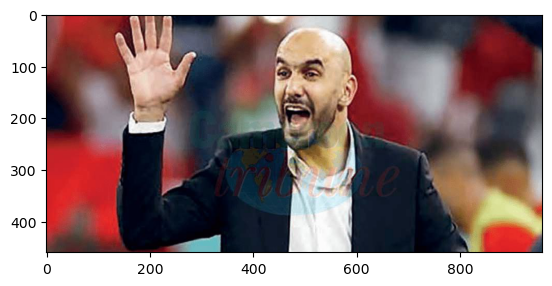

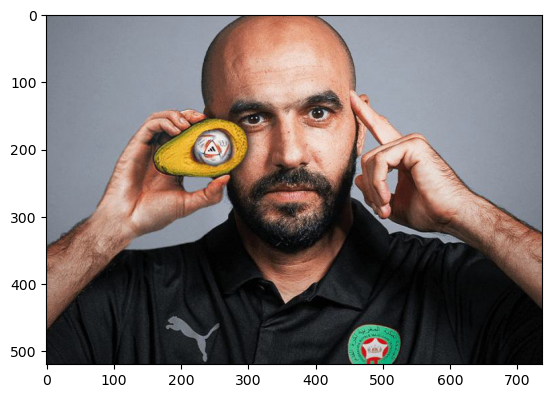

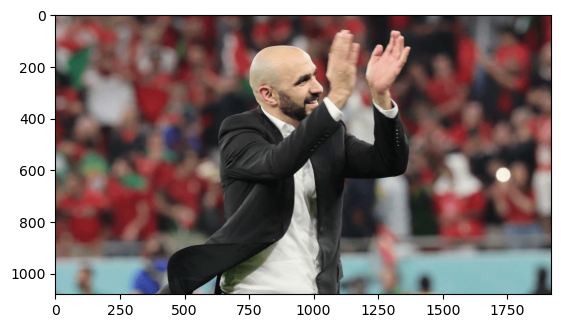

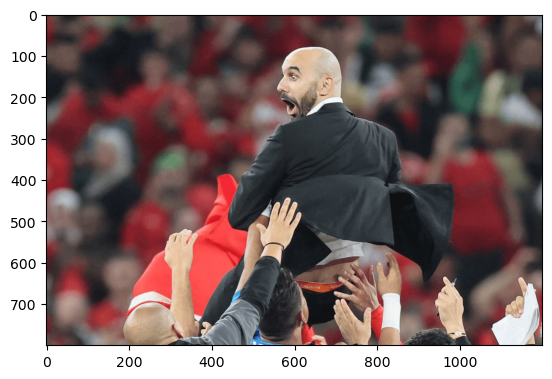

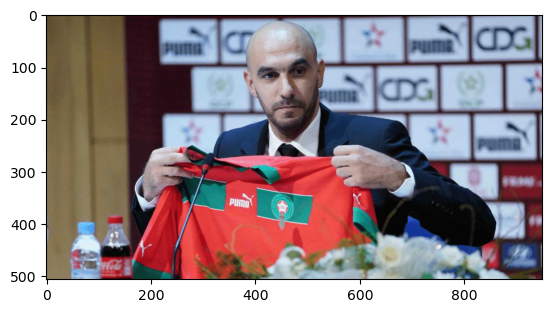

...

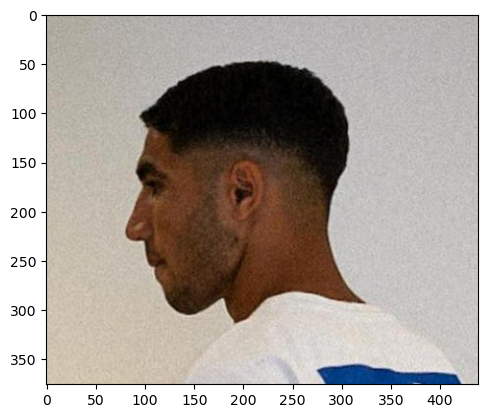

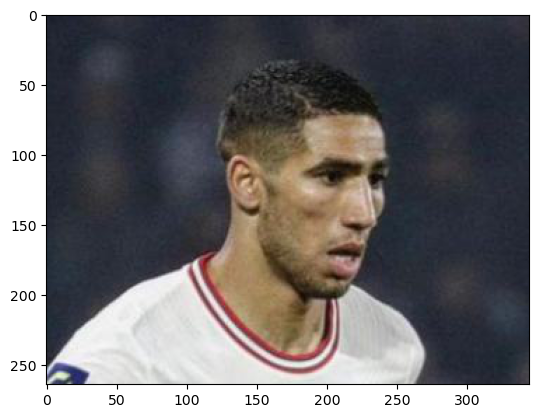

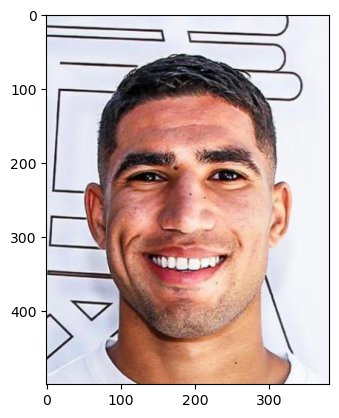

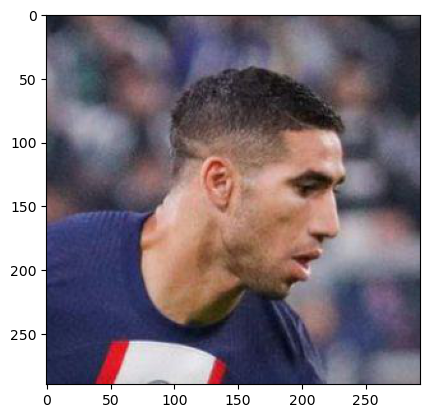

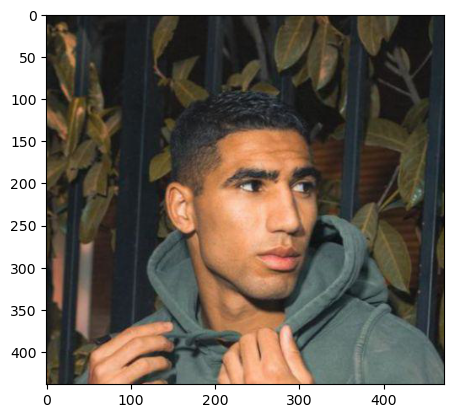

In [3]:
# Iterate over the images in the list
for img in imgs:
    plt.imshow(img)
    plt.show()


## Show all our images in a grid

### Data cleaning 

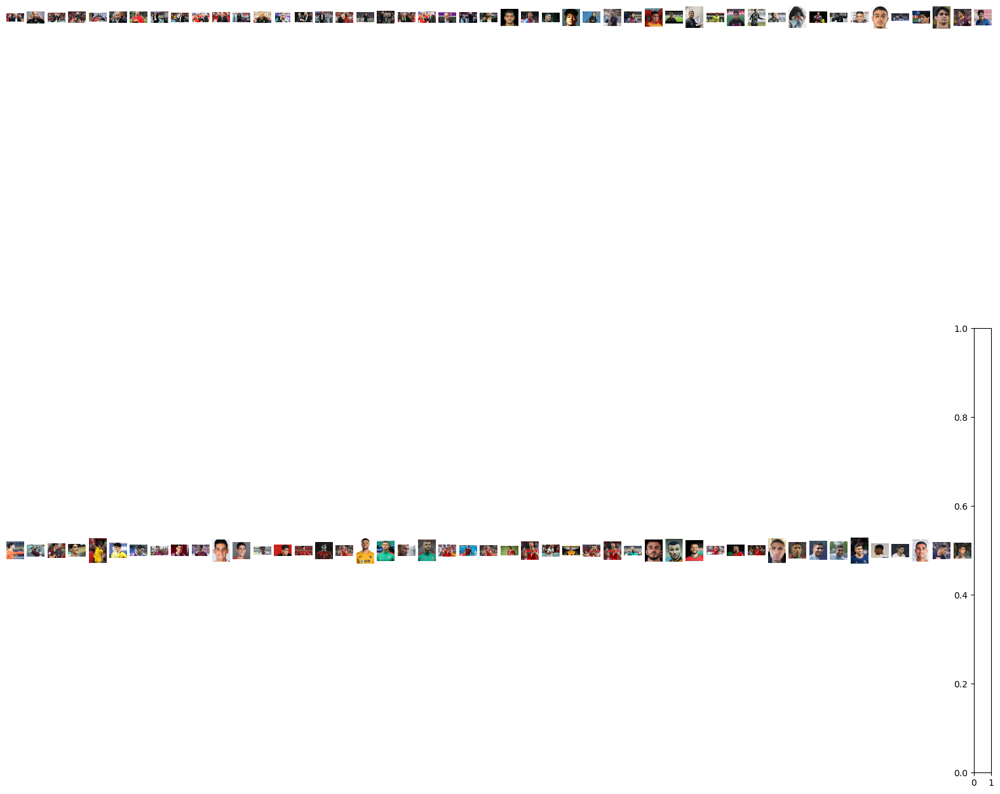

In [4]:
import matplotlib.pyplot as plt

# number of images
n = len(imgs)
# set the number of rows and columns
rows = 2
cols = (n+1)//rows

fig, myaxis = plt.subplots(rows, cols, figsize=(20,20))
myaxis = myaxis.ravel()#ravel method is used to flatten the 2D array of 
#axes objects that is returned into a 1D array.

# iterate over the images
for i,img in enumerate(imgs):
    myaxis[i].imshow(img)
    myaxis[i].axis('off')
plt.show()

## First method put our data in a new file with all the image as jpeg

In [7]:
import os
from PIL import Image

#First method put our data in a new file with all the image as jpeg

root_dir = '/Users/mohamedabdallaoui/Desktop/Projet Equip Maroc/Dataset - Equipe Maroc/Dataset - Equipe Maroc 2'
output_folder = '/Users/mohamedabdallaoui/Desktop/test1'

# Create the output folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Suppress the UserWarning
# warnings.simplefilter("ignore", UserWarning)

for subdir, dirs, files in os.walk(root_dir):
    for file in files:
        if file.endswith(".jpg") or file.endswith(".jpeg") or file.endswith(".png") or file.endswith(".bmp"):
            filepath = os.path.join(subdir, file)
            img = Image.open(filepath)
            base_filename, ext = os.path.splitext(file)
            img = img.convert("RGB")
            # Creates the output file path
            output_subdir = subdir.replace(root_dir, output_folder)
            if not os.path.exists(output_subdir):
                os.makedirs(output_subdir)
            output_path = os.path.join(output_subdir, base_filename + '.jpeg')
            img.save(output_path, 'JPEG')


### Second methode keep our old data in a backup and modify our set of data in the same folder to jpeg

In [8]:
import os
from PIL import Image
import warnings 

import shutil
#CHECK CHECK
# Second methode keep our old data in a backup and modify our set of data in the same folder to jpeg
root_dir = '/Users/mohamedabdallaoui/Desktop/Projet Equip Maroc/Dataset - Equipe Maroc/Dataset - Equipe Maroc 2'
output_folder = '/Users/mohamedabdallaoui/Desktop/test1'


backup_folder = '/Users/mohamedabdallaoui/Desktop/Dataset - Equipe Maroc/backup'

# Create the backup folder if it doesn't exist
if not os.path.exists(backup_folder):
    os.makedirs(backup_folder)

# Suppress the UserWarning
warnings.simplefilter("ignore", UserWarning)

for subdir, dirs, files in os.walk(root_dir):
    for file in files:
        
        #Process all the image files with the extensions: jpg, jpeg, png, or webp.
        if file.endswith(".jpg") or file.endswith(".jpeg") or file.endswith(".png") or file.endswith(".webp"):
            filepath = os.path.join(subdir, file)
        #Copy these image files to a backup directory before modification
            backup_path = os.path.join(backup_folder, file)
            shutil.copy2(filepath, backup_path)
            img = Image.open(filepath)
            base_filename, ext = os.path.splitext(file)
            img = img.convert("RGB")
            # Creates the output file path
        #Convert these images to the jpeg format, replacing the original files, 
            output_path = os.path.join(subdir, base_filename + '.jpeg')
            img.save(output_path, 'JPEG')
            os.remove(filepath)


## Split data Train and test 

In [19]:
from sklearn.model_selection import train_test_split
import pandas as pd

root_dir = '/Users/mohamedabdallaoui/Desktop/Projet Equip Maroc/Dataset - Equipe Maroc/Dataset - Equipe Maroc 2'
output_folder = '/Users/mohamedabdallaoui/Desktop/test1'

image_paths = []
labels = []

# Extract the image paths and labels
for subdir, dirs, files in os.walk(root_dir):
    for file in files:
        if file.endswith(".jpg") or file.endswith(".jpeg") or file.endswith(".png") or file.endswith(".bmp"):
            filepath = os.path.join(subdir, file)
            image_paths.append(filepath)
            labels.append("Anass Zeroury")

# Create a dataframe using the image paths and labels
df = pd.DataFrame({'image_path': image_paths, 'AZR': labels})

# split the dataframe into train and test sets
X_train, X_test, y_train, y_test = train_test_split(df['image_path'], df['AZR'], test_size=0.2, random_state=42)


In [20]:
X_train

66    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
15    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
78    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
79    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
30    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
                            ...                        
60    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
71    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
14    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
92    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
51    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
Name: image_path, Length: 76, dtype: object

In [21]:
y_train

66    Anass Zeroury
15    Anass Zeroury
78    Anass Zeroury
79    Anass Zeroury
30    Anass Zeroury
          ...      
60    Anass Zeroury
71    Anass Zeroury
14    Anass Zeroury
92    Anass Zeroury
51    Anass Zeroury
Name: AZR, Length: 76, dtype: object

In [22]:
y_test

68    Anass Zeroury
22    Anass Zeroury
72    Anass Zeroury
73    Anass Zeroury
0     Anass Zeroury
26    Anass Zeroury
40    Anass Zeroury
42    Anass Zeroury
10    Anass Zeroury
45    Anass Zeroury
84    Anass Zeroury
55    Anass Zeroury
81    Anass Zeroury
47    Anass Zeroury
12    Anass Zeroury
4     Anass Zeroury
18    Anass Zeroury
28    Anass Zeroury
39    Anass Zeroury
Name: AZR, dtype: object

In [23]:
y_train

66    Anass Zeroury
15    Anass Zeroury
78    Anass Zeroury
79    Anass Zeroury
30    Anass Zeroury
          ...      
60    Anass Zeroury
71    Anass Zeroury
14    Anass Zeroury
92    Anass Zeroury
51    Anass Zeroury
Name: AZR, Length: 76, dtype: object

In [24]:
X_test

68    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
22    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
72    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
73    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
0     /Users/mohamedabdallaoui/Desktop/Projet Equip ...
26    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
40    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
42    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
10    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
45    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
84    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
55    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
81    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
47    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
12    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
4     /Users/mohamedabdallaoui/Desktop/Projet Equip ...
18    /Users/mohamedabdallaoui/Desktop/Projet Equip ...
28    /Users/mohamedabdallaoui/Desktop/Projet Eq

In [25]:
df

,image_path,AZR
0,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury
1,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury
2,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury
3,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury
4,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury
...,...,...
90,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury
91,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury
92,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury
93,/Users/mohamedabdallaoui/Desktop/Projet Equip ...,Anass Zeroury


In [26]:
print("X_train shape",X_train.shape)
print("y_train shape",y_train.shape)
print("X_test shape",X_test.shape)
print("y_test shape",y_test.shape)

X_train shape (76,)
y_train shape (76,)
X_test shape (19,)
y_test shape (19,)


# To train your data to recognize a new image, you can use a deep learning model like a convolutional neural network (CNN) and fine-tune it using transfer learning.

## 1Import necessary libraries:

In [36]:

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers


### Load and preprocess your data: You will need to load your image data and labels, and then preprocess them by normalizing the pixel values and converting the labels to one-hot encoded vectors.

In [41]:
import keras
from keras.datasets import mnist
from keras.utils import to_categorical

# Load data
(X_train, y_train), (X_test, y_test) = mnist.load_data()

# Normalize pixel values
X_train = X_train / 255.0
X_test = X_test / 255.0

# Splitting the train data into train and validation sets
X_val, y_val = X_train[50000:], y_train[50000:]
X_train, y_train = X_train[:50000], y_train[:50000]

# Convert labels to one-hot encoded vectors
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)
y_val = to_categorical(y_val)


11490434/11490434 [==============================] - 11s 1us/step


In [56]:
# Normalize pixel values

if X_train.dtype != 'float':
    X_train = X_train.astype(float)
X_train = X_train / 255.0
X_test = X_test.astype(float) / 255.0

# Convert labels to one-hot encoded vectors
y_train = keras.utils.to_categorical(y_train)
y_test = keras.utils.to_categorical(y_test)


### Define the model architecture: You can use a pre-trained model like VGG16 or ResNet50 and remove the last fully connected layer. Then add new layers to the model to adapt it to your dataset.

In [61]:
# Load the dataset
(X_train, y_train), (X_test, y_test) = keras.datasets.cifar10.load_data()

In [62]:
# Import necessary libraries
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

# Load the dataset
# (X_train, y_train), (X_test, y_test) = keras.datasets.cifar10.load_data()

# Normalize pixel values between 0 and 1
X_train = X_train / 255.0
X_test = X_test / 255.0

# Create the model architecture using sequential API
model = keras.Sequential([
    #Convolutional layer
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(32, 32, 3)),
    #Maxpooling layer
    layers.MaxPooling2D((2, 2)),
    #Flatten the output
    layers.Flatten(),
    #Dense layer
    layers.Dense(64, activation='relu'),
    #output layer
    layers.Dense(10, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=3)

# Evaluate the model on test set
test_loss, test_acc = model.evaluate(X_test, y_test, verbose=2)
print(test_acc)




Epoch 1/3
1563/1563 [==============================] - 22s 12ms/step - loss: 1.4810 - accuracy: 0.4732
Epoch 2/3
1563/1563 [==============================] - 19s 12ms/step - loss: 1.1737 - accuracy: 0.5910
Epoch 3/3
1563/1563 [==============================] - 21s 13ms/step - loss: 1.0711 - accuracy: 0.6255
313/313 - 1s - loss: 1.1201 - accuracy: 0.6063 - 989ms/epoch - 3ms/step
0.6062999963760376


## save the model to a file 

In [63]:
# Save the model to a file
model.save('/Users/mohamedabdallaoui/Desktop/Projet Equip Maroc/Dataset - Equipe Maroc/mymodel.h5')

In [64]:
model.predict(X_test)

313/313 [==============================] - 1s 2ms/step


array([[2.8085044e-02, 2.6451339e-04, 2.7882222e-02, ..., 8.5426937e-04,
        1.6143806e-01, 6.0000352e-04],
       [1.3299461e-01, 3.7703282e-01, 6.8213732e-05, ..., 3.4736370e-06,
        4.8675087e-01, 3.0826551e-03],
       [5.2984536e-01, 7.8362063e-02, 5.0452566e-03, ..., 7.5574557e-04,
        3.6293820e-01, 1.8696457e-02],
       ...,
       [3.5494522e-04, 4.4565175e-05, 9.1102704e-02, ..., 1.5601834e-02,
        1.1561190e-04, 1.2512995e-04],
       [2.4643067e-01, 3.0259511e-01, 1.8367153e-02, ..., 6.0525239e-03,
        2.4557698e-03, 3.3879541e-03],
       [1.6676739e-03, 2.6775210e-04, 1.6481327e-02, ..., 5.4883373e-01,
        1.5996596e-04, 7.5655343e-04]], dtype=float32)

In [65]:
model.predict(X_train)

1563/1563 [==============================] - 3s 2ms/step


array([[9.4371341e-04, 6.7793342e-05, 4.0670101e-02, ..., 1.2717810e-02,
        6.3757172e-05, 2.1082982e-04],
       [2.9531293e-02, 1.4764677e-01, 1.8612035e-02, ..., 1.5667720e-02,
        5.5857119e-03, 7.7601200e-01],
       [4.5336112e-02, 6.2730029e-02, 2.0346027e-02, ..., 5.9525785e-03,
        2.6699790e-01, 4.6554402e-01],
       ...,
       [4.2167059e-01, 5.0453406e-02, 2.6580649e-03, ..., 5.2282406e-04,
        7.3481023e-02, 4.4661573e-01],
       [2.0445317e-02, 7.6510382e-01, 2.6266417e-04, ..., 5.2475149e-05,
        1.7393781e-01, 3.9484024e-02],
       [5.8485818e-01, 1.3105050e-01, 3.1388804e-02, ..., 1.3319452e-01,
        3.2522205e-02, 4.6824630e-02]], dtype=float32)

In [127]:
# import the necessary modules
import numpy as np
from PIL import Image
from tensorflow.keras.utils import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# load the image and resize it to (32, 32)
image = Image.open('/Users/mohamedabdallaoui/Desktop/Projet Equip Maroc/Dataset - Equipe Maroc/anas_zarzouri.jpeg').resize((32, 32))

# convert the image to a numpy array
image = img_to_array(image)

# preprocess the image
image = tf.image.rgb_to_grayscale(image)

image = np.array(image)
image = image / 255.0  # normalize pixel values
image = np.expand_dims(image, axis=-1)  # add a dimension for the color channel

# use the model to make a prediction

images = ['/Users/mohamedabdallaoui/Desktop/Projet Equip Maroc/Dataset - Equipe Maroc/Dataset - Equipe Maroc 2/Anass Zeroury/10-1.jpeg','/Users/mohamedabdallaoui/Desktop/Projet Equip Maroc/Dataset - Equipe Maroc/Dataset - Equipe Maroc 2/Anass Zeroury/10-2.jpeg']
images = [img_to_array(load_img(img,target_size=(32,32))) for img in images]
images = np.array(images)
# make a prediction
predictions = model.predict(images)

# print the predicted class
print(np.argmax(predictions))


1/1 [==============================] - 0s 25ms/step
5
